# <center><B>DATASET</center>

1. [Importing Libraries](#importing-libraries)
2. [Loading the Dataset](#loading-the-dataset)
3. [Dataset Overview](#dataset-overview)
4. [Data Info](#data-info)
5. [Data Cleaning](#data-cleaning)
    - [Eliminating Duplicates](#eliminating-duplicates)
    - [Data Transformation: Date and Time Parsing](#data-transformation:-date-and-time-parsing)
    - [Checking for Null Values in Each Column](#checking-for-null-values-in-each-column)
    - [Dropping Unnecessary Columns](#dropping-unnecessary-columns)
    - [Examining Continuous Variables](#examining-continuous-variables)
6. [Print All Columns](#print-all-columns)
7. [Theme Setting](#theme-setting)
8. [Data Visualization: Using Plots to Find Relationships Between Features](#data-visualization)
    

<br>

 ## <b><a name="importing-libraries"></a>Importing Libraries 

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import folium
from folium.plugins import MarkerCluster
import webbrowser
import datetime
import plotly.express as px
from IPython.display import display
from geopy.geocoders import Nominatim

<br>

## <b><a name="loading-the-dataset"></a>Loading the Dataset


In [2]:
file_path = "database.csv"  # Update with your file path
df = pd.read_csv("C:\\Users\\DELL8\\OneDrive\\Desktop\\database.csv",dtype={25: str})

<br>

## <b><a name="dataset-overview"></a>Dataset Overview


In [3]:
df

,Date,Time,Latitude,Longitude,Type,Depth,Depth Error,Depth Seismic Stations,Magnitude,Magnitude Type,...,Magnitude Seismic Stations,Azimuthal Gap,Horizontal Distance,Horizontal Error,Root Mean Square,ID,Source,Location Source,Magnitude Source,Status
0,01/02/1965,13:44:18,19.2460,145.6160,Earthquake,131.60,NaN,NaN,6.0,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic
1,01/04/1965,11:29:49,1.8630,127.3520,Earthquake,80.00,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic
2,01/05/1965,18:05:58,-20.5790,-173.9720,Earthquake,20.00,NaN,NaN,6.2,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic
3,01/08/1965,18:49:43,-59.0760,-23.5570,Earthquake,15.00,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic
4,01/09/1965,13:32:50,11.9380,126.4270,Earthquake,15.00,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23407,12/28/2016,08:22:12,38.3917,-118.8941,Earthquake,12.30,1.2,40.0,5.6,ML,...,18.0,42.47,0.120,NaN,0.1898,NN00570710,NN,NN,NN,Reviewed
23408,12/28/2016,09:13:47,38.3777,-118.8957,Earthquake,8.80,2.0,33.0,5.5,ML,...,18.0,48.58,0.129,NaN,0.2187,NN00570744,NN,NN,NN,Reviewed
23409,12/28/2016,12:38:51,36.9179,140.4262,Earthquake,10.00,1.8,NaN,5.9,MWW,...,NaN,91.00,0.992,4.8,1.5200,US10007NAF,US,US,US,Reviewed
23410,12/29/2016,22:30:19,-9.0283,118.6639,Earthquake,79.00,1.8,NaN,6.3,MWW,...,NaN,26.00,3.553,6.0,1.4300,US10007NL0,US,US,US,Reviewed


<br>

## <B><a name="data-info"></a>Data Info

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23412 entries, 0 to 23411
Data columns (total 21 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Date                        23412 non-null  object 
 1   Time                        23412 non-null  object 
 2   Latitude                    23412 non-null  float64
 3   Longitude                   23412 non-null  float64
 4   Type                        23412 non-null  object 
 5   Depth                       23412 non-null  float64
 6   Depth Error                 4461 non-null   float64
 7   Depth Seismic Stations      7097 non-null   float64
 8   Magnitude                   23412 non-null  float64
 9   Magnitude Type              23409 non-null  object 
 10  Magnitude Error             327 non-null    float64
 11  Magnitude Seismic Stations  2564 non-null   float64
 12  Azimuthal Gap               7299 non-null   float64
 13  Horizontal Distance         160

<br>

 ## <b><a name="data-cleaning"></a>Data Cleaning

<br>

#### <a name="eliminating-duplicates"></a>Eliminating Duplicates

In [5]:
df.duplicated().sum()
df.drop_duplicates(inplace=True)

<br>

#### <a name="checking-for-null-values-in-each-column"></a>Checking for Null Values in Each Column





In [6]:
df.isnull().sum()

Date                              0
Time                              0
Latitude                          0
Longitude                         0
Type                              0
Depth                             0
Depth Error                   18951
Depth Seismic Stations        16315
Magnitude                         0
Magnitude Type                    3
Magnitude Error               23085
Magnitude Seismic Stations    20848
Azimuthal Gap                 16113
Horizontal Distance           21808
Horizontal Error              22256
Root Mean Square               6060
ID                                0
Source                            0
Location Source                   0
Magnitude Source                  0
Status                            0
dtype: int64

<br>

#### <a name="data-transformation:-date-and-time-parsing"></a>Data Transformation: Date and Time Parsing

In [7]:
df['Time'] = pd.to_datetime(df['Time'], format='%H:%M:%S', errors='coerce')
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
df['Hour'] = pd.to_datetime(df['Time'], format='%H:%M:%S', errors='coerce').dt.hour
df['Weekday'] = df['Date'].dt.day_name() 


<br>

#### <a name="dropping-unnecessary-columns"></a>Dropping Unnecessary

In [8]:
columns_to_drop = ["Depth Error", "Depth Seismic Stations", "Magnitude Error", 
    "Magnitude Seismic Stations", "Azimuthal Gap", "Horizontal Distance", 
    "Horizontal Error", "ID", "Source", "Location Source", "Magnitude Source", "Status"]
df_cleaned = df.drop(columns=columns_to_drop, axis=1)

In [9]:
df = df.dropna(subset=['Hour', 'Magnitude'])

In [10]:
critical_columns = ['Latitude', 'Longitude', 'Magnitude', 'Depth', 'Type']
df_cleaned = df_cleaned.dropna(subset=critical_columns)

In [11]:
df_cleaned_info = df_cleaned.info()
df_cleaned_head = df_cleaned.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23412 entries, 0 to 23411
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   Date              23409 non-null  datetime64[ns]
 1   Time              23409 non-null  datetime64[ns]
 2   Latitude          23412 non-null  float64       
 3   Longitude         23412 non-null  float64       
 4   Type              23412 non-null  object        
 5   Depth             23412 non-null  float64       
 6   Magnitude         23412 non-null  float64       
 7   Magnitude Type    23409 non-null  object        
 8   Root Mean Square  17352 non-null  float64       
 9   Hour              23409 non-null  float64       
 10  Weekday           23409 non-null  object        
dtypes: datetime64[ns](2), float64(6), object(3)
memory usage: 2.0+ MB


<br>

#### <a name="examining-continuous-variables"></a>Examining Continuous Variables

In [12]:
df.describe()


,Date,Time,Latitude,Longitude,Depth,Depth Error,Depth Seismic Stations,Magnitude,Magnitude Error,Magnitude Seismic Stations,Azimuthal Gap,Horizontal Distance,Horizontal Error,Root Mean Square,Hour
count,23409,23409,23409.000000,23409.000000,23409.000000,4460.000000,7096.000000,23409.000000,327.000000,2564.000000,7298.000000,1604.000000,1156.000000,17350.000000,23409.000000
mean,1993-02-18 00:22:56.701268736,1900-01-01 11:56:43.179546368,1.678763,39.636726,70.748526,4.991118,275.362176,5.882558,0.071820,48.944618,44.165158,3.992660,7.662759,1.022766,11.449015
min,1965-01-02 00:00:00,1900-01-01 00:00:03,-77.080000,-179.997000,-1.100000,0.000000,0.000000,5.500000,0.000000,0.000000,0.000000,0.004505,0.085000,0.000000,0.000000
25%,1981-04-11 00:00:00,1900-01-01 05:58:43,-18.652000,-76.352000,14.530000,1.800000,146.000000,5.600000,0.046000,10.000000,24.100000,0.968750,5.300000,0.900000,5.000000
50%,1993-11-30 00:00:00,1900-01-01 11:54:56,-3.569000,103.981000,33.000000,3.500000,255.000000,5.700000,0.059000,28.000000,36.000000,2.319500,6.700000,1.000000,11.000000
75%,2005-09-09 00:00:00,1900-01-01 17:57:19,26.188000,145.027000,54.000000,6.300000,384.000000,6.000000,0.075500,66.000000,54.000000,4.724500,8.100000,1.130000,17.000000
max,2016-12-30 00:00:00,1900-01-01 23:59:58,86.005000,179.998000,700.000000,91.295000,934.000000,9.100000,0.410000,821.000000,360.000000,37.874000,99.000000,3.440000,23.000000
std,NaN,NaN,30.113379,125.514881,122.605748,4.873905,162.152976,0.423084,0.051466,62.943106,32.143388,5.377262,10.430396,0.188544,6.890925


<br>

#### <a name="print-all-columns"></a>Print All Columns 


In [13]:
df.columns

Index(['Date', 'Time', 'Latitude', 'Longitude', 'Type', 'Depth', 'Depth Error',
       'Depth Seismic Stations', 'Magnitude', 'Magnitude Type',
       'Magnitude Error', 'Magnitude Seismic Stations', 'Azimuthal Gap',
       'Horizontal Distance', 'Horizontal Error', 'Root Mean Square', 'ID',
       'Source', 'Location Source', 'Magnitude Source', 'Status', 'Hour',
       'Weekday'],
      dtype='object')

<br>

#### <a name="theme-setting"></a>Theme Setting

In [14]:
sns.set_theme(style="whitegrid")

<br>

### <a name="data-visualization"></a>Data Visualization

<br>

 <a name="magnitude-over-time"></a>Magnitude Over Time

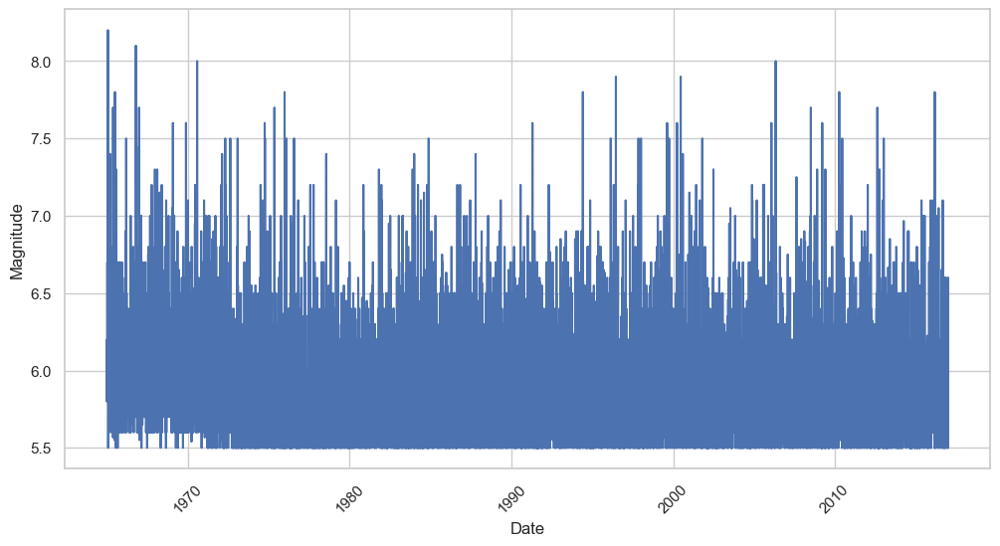

In [15]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=df, x='Date', y='Magnitude', ci=None)
plt.xticks(rotation=45)
plt.show()

<B>Explantion:<br>

This line plot visualizes the magnitude of earthquakes over time. The x-axis represents the dates of the earthquakes, while the y-axis shows the magnitude of each earthquake. The plot connects the earthquake magnitudes across different dates, helping customers observe how the magnitude of earthquakes changes over time. The absence of a confidence interval (ci=None) ensures the plot only shows the actual data points without any uncertainty shading. The x-axis labels are rotated for better readability, especially for longer date formats. This plot provides insights into the trend and fluctuations of earthquake magnitudes over the observed period.

<B>Observation:<br>

The line plot illustrates the trend of the Magnitude variable over time. Peaks and valleys in the plot indicate fluctuations in magnitude on specific dates, potentially corresponding to significant seismic events or other related occurrences.

<b>Conclusion:<br>

By visualizing the magnitude over time, we can identify periods of increased seismic activity. This plot helps in understanding how the magnitude varies on different dates, providing insight into patterns or anomalies that may be associated with specific events or trends.








<br>

<a name="relationships-between-magnitude-Depth-and-horizontal-distance"></a>Relationships Between Magnitude, Depth, and Horizontal Distance

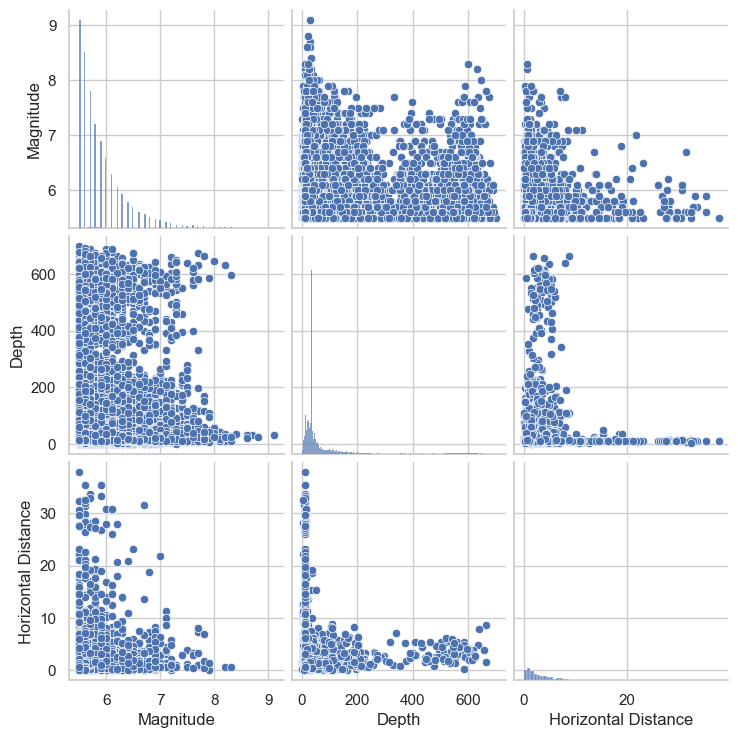

In [16]:
sns.pairplot(df[['Magnitude', 'Depth', 'Horizontal Distance']])
plt.show()

<B>Expanation:<br>

This pair plot visualizes the relationships between three variables: Magnitude, Depth, and Horizontal Distance. It creates scatter plots for each pair of these variables, allowing customers to see how they are correlated with each other. Diagonal plots show the distribution of each variable individually. The scatter plots help identify any trends or patterns, such as whether greater magnitudes are associated with deeper earthquakes or varying distances. This plot is useful for understanding how these variables interact and for identifying potential relationships between them.

<B>Observation:<br>

The pairplot visualizes the relationships between the Magnitude, Depth, and Horizontal Distance variables. It shows the pairwise scatter plots along with the distribution of each variable. This reveals how each of these variables is distributed and how they correlate with one another.

<b>Conclusion:<br>

The pairplot suggests potential correlations between the variables, especially between Magnitude and Depth, where deeper events might be associated with higher magnitudes. The scatter plots help identify trends and outliers, providing insights into how these variables interact. Further statistical analysis could quantify the strength of these relationships and explore any hidden patterns.


<br>

<a name="magnitude-by-time-of-day"></a>Magnitude by Time of Day

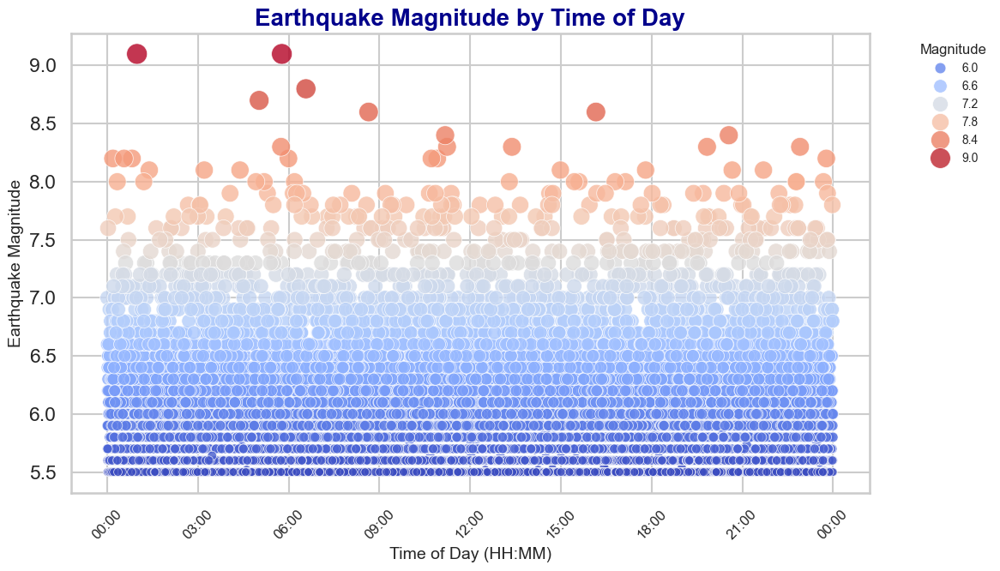

In [35]:
# Convert 'Time' to datetime format for proper plotting
df['Time'] = pd.to_datetime(df['Time'], format='%H:%M')

# Set Seaborn style for better aesthetics
sns.set_theme(style="whitegrid", context="talk")

# Create a scatter plot with adjusted sizes and color scheme
plt.figure(figsize=(12, 7))  # Adjust plot size for better readability
scatter = sns.scatterplot(
    x='Time', 
    y='Magnitude', 
    data=df, 
    alpha=0.8, 
    hue='Magnitude',  # Color points based on their magnitude for clear differentiation
    palette='coolwarm',  # Color scheme from cool (low magnitude) to warm (high magnitude)
    size='Magnitude',  # Size of points varies based on magnitude
    sizes=(50, 300)  # Set the range for the size of the points
)

# Set a title with enhanced readability
plt.title('Earthquake Magnitude by Time of Day', fontsize=20, fontweight='bold', color='darkblue')

# Add clearer axis labels
plt.xlabel('Time of Day (HH:MM)', fontsize=14)
plt.ylabel('Earthquake Magnitude', fontsize=14)

# Format the x-axis to display only hours and minutes in a user-friendly manner
scatter.xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%H:%M'))
plt.xticks(rotation=45, fontsize=12)  # Rotate x-axis labels for better readability

# Add a legend to explain point sizes and colors
plt.legend(
    title='Magnitude',
    title_fontsize=12,
    loc='upper left', 
    bbox_to_anchor=(1.05, 1), 
    fontsize=10,
    frameon=False  # Optional: Remove frame for a cleaner look
)

# Improve layout to prevent clipping of labels or legend
plt.tight_layout()

# Display the plot
plt.show()


<B>Explanation:<br>

This scatter plot shows the relationship between earthquake magnitudes and time of day. The x-axis represents time (HH:MM), while the y-axis shows the magnitude. Points are color-coded by magnitude, with cooler colors for lower values and warmer colors for higher ones. The point size also varies based on magnitude, providing a clear visual representation of how earthquake magnitudes change throughout the day.

<B>Observation:<br>

The scatter plot reveals how Magnitude varies throughout the day. The data points are spread across the time range, showing fluctuations in magnitude at different times, with some periods having higher or more concentrated magnitudes.

<b>Conclusion:<br>

This plot suggests that seismic or event magnitudes fluctuate at different times of the day, with no clear trend of uniformity. By analyzing the spread of magnitudes over time, we can identify specific time windows where more significant events might occur, which could be useful for understanding patterns of activity or predicting future occurrences.









<br>

<a name="magnitude-distribution-by-hour"></a>Magnitude Distribution by Hour

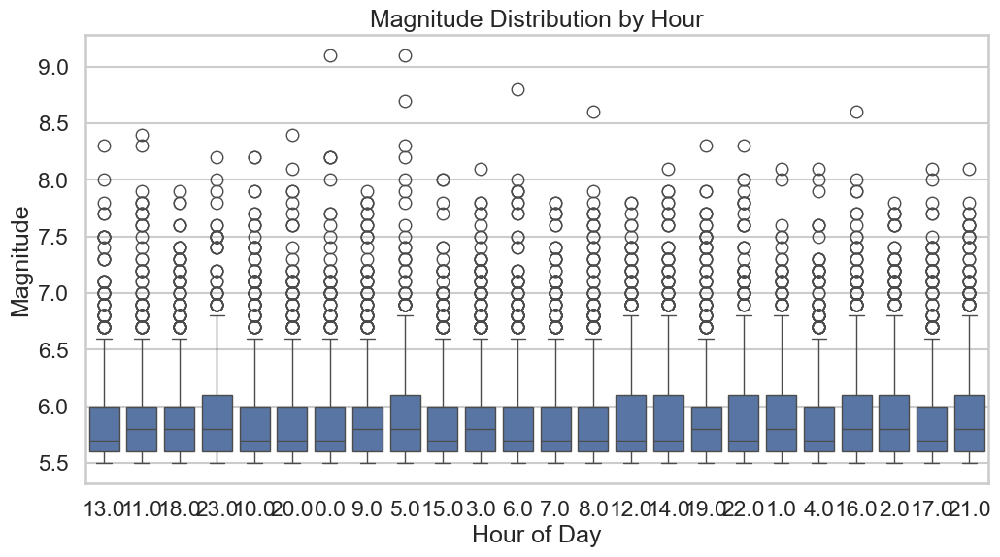

In [18]:
df['Hour'] = df['Hour'].astype(str)
plt.figure(figsize=(12, 6))

sns.boxplot(data=df, x='Hour', y='Magnitude')
plt.title("Magnitude Distribution by Hour")
plt.xlabel("Hour of Day")
plt.ylabel("Magnitude")
plt.show()

<B>Explanation:<br>

This box plot shows the distribution of earthquake magnitudes across each hour of the day. It highlights the median, quartiles, and outliers for magnitudes at different hours, helping to identify time-based patterns in earthquake intensity.

<B>Observation:<br>

The box plot shows how Magnitude varies across different hours of the day. It indicates that some hours experience larger magnitudes (larger interquartile ranges and higher outliers), while others have smaller or more consistent magnitudes.

<b>Conclusion:<br>

This plot suggests that seismic activity or event magnitude fluctuates throughout the day, with certain hours exhibiting more significant events. Analyzing the time-based distribution of magnitude can help in identifying patterns or peaks in seismic activity, which could be valuable for predictive modeling or resource planning.


<br>

<a name="magnitude-distribution-by-weekday"></a> Magnitude Distribution by Weekday

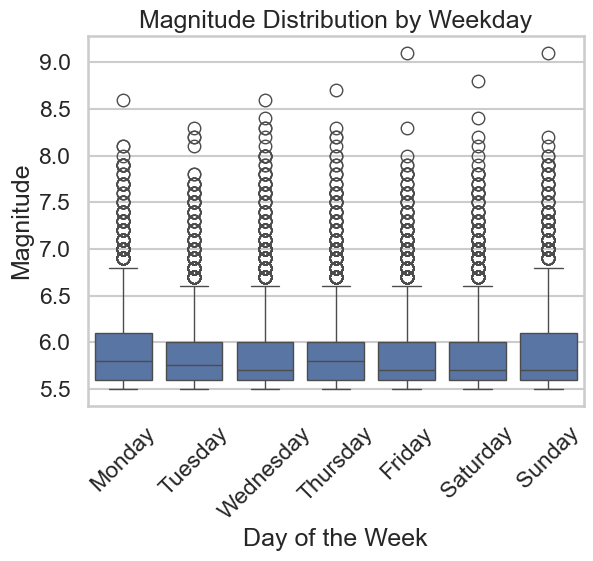

In [19]:
sns.boxplot(data=df, x='Weekday', y='Magnitude', order=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])
plt.title("Magnitude Distribution by Weekday")
plt.xlabel("Day of the Week")
plt.ylabel("Magnitude")
plt.xticks(rotation=45)
plt.show()

<B>Expanation:<br>

This box plot shows the distribution of earthquake magnitudes across the days of the week. The x-axis represents the days, and the y-axis shows the magnitude values. It highlights the median, quartiles, and outliers for each day, allowing easy comparison of magnitude distributions across weekdays.

<B>Observation:<br>

The box plot shows the distribution of Magnitude across different days of the week. It reveals that certain weekdays have higher or more varied magnitudes, with some days having more outliers (indicating larger seismic events) compared to others.

<b>Conclusion:<br>

The plot suggests that the distribution of magnitudes is not uniform throughout the week, and some days might experience more significant seismic activity. This could indicate potential patterns related to specific events or cycles, which may warrant further investigation for weekly trends in magnitude.


<br>

 <a name="dept-distribution-by-month"></a>Depth Distribution by Month

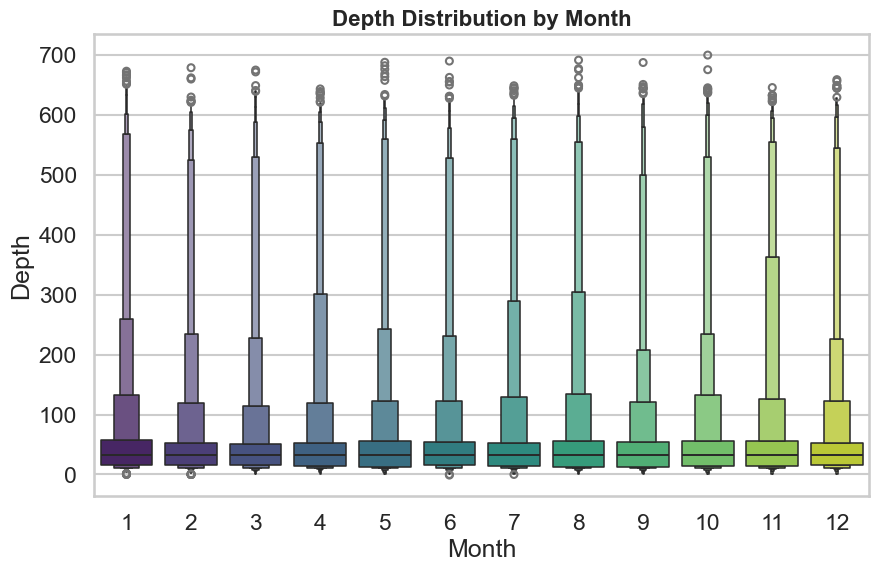

In [20]:
df['Month'] = df['Date'].dt.month  # Extract month
plt.figure(figsize=(10, 6))
sns.boxenplot(data=df, x='Month', y='Depth', palette='viridis')
plt.title("Depth Distribution by Month", fontsize=16, weight='bold')

plt.show()

<B>Explanation:<br>

This boxen plot visualizes the distribution of depths across different months. The x-axis represents the months of the year, while the y-axis shows the depth values of the events (e.g., earthquakes). The boxen plot highlights the distribution, spread, and outliers in depth data for each month. The use of the viridis color palette enhances the visualization with a color gradient that helps distinguish different months. This plot provides insights into how the depth of events varies by month, helping customers observe trends, patterns, or seasonality in the data.

<B>Observation:<br>

The boxen plot displays the distribution of Depth values across different months. It shows that the depth varies significantly, with some months exhibiting larger interquartile ranges and occasional outliers, particularly in certain months where deeper events seem more frequent.

<b>Conclusion:<br>

This plot reveals that depth distribution is not uniform across the year. Specific months may experience more intense or deeper events, while others show more consistent and shallow depths. This pattern can help identify seasonal or cyclical trends in depth, which could be useful for further investigations into environmental or geological factors.


<br>

Magnitude Type Distribution Analysis

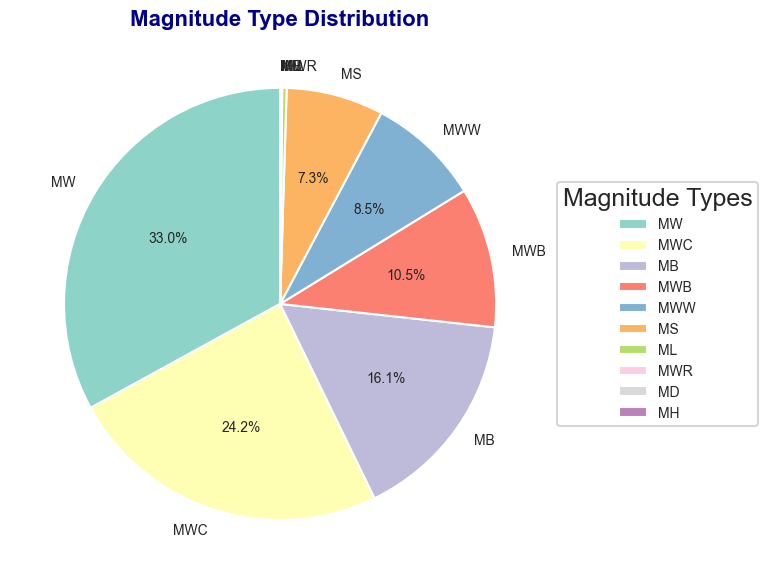

In [21]:

# Define colors for the pie chart
colors = plt.cm.Set3(range(len(df['Magnitude Type'].value_counts())))

# Create the pie chart
plt.figure(figsize=(8, 8))  # Larger size for better visibility
values = df['Magnitude Type'].value_counts()
labels = values.index

# Plot pie chart without percentage labels on the slices
wedges, texts, autotexts = plt.pie(
    values,
    labels=labels,
    autopct=lambda pct: f'{pct:.1f}%' if pct > 5 else '',
    startangle=90,
    colors=colors,
    textprops={'fontsize': 10},  # Adjust font size
    wedgeprops={'edgecolor': 'white', 'linewidth': 1.5}  # Add white borders
)

# Add a legend to avoid overlapping
plt.legend(
    wedges, labels, title="Magnitude Types", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1), fontsize=10
)

# Add a title and adjust layout
plt.title('Magnitude Type Distribution', fontsize=16, fontweight='bold', color='darkblue')
plt.tight_layout()  # Ensure proper spacing

plt.show()


<B>Expanation:<br>

This pie chart visualizes the distribution of magnitude types in the dataset, with each slice representing a different type and its size proportional to the frequency of occurrences. Distinct colors from the Set3 colormap are used to differentiate the types, and percentage labels are shown for slices with more than 5% of the total. A legend placed to the right ensures clear identification of each type, while white borders around the slices enhance visual clarity. The chart provides a clear, easily interpretable breakdown of the magnitude type distribution, allowing customers to quickly see which types are most and least common.

<B>Observation:<br>

The pie chart represents the distribution of different magnitude types present in the dataset. The custom_autopct function ensures that only segments with more than 5% of the total are labeled, reducing visual clutter.

<b>Conclusion:<br>

The dataset is dominated by a single magnitude type (Mw), accounting for more than 95% of the events, indicating that other magnitude types are either underrepresented or absent. This could reflect a dataset focusing specifically on this magnitude type, which is often used for standard earthquake measurements.










<br>

Customizable Pie Chart Function: create_pie_chart

In [22]:
def create_pie_chart(data, title, cmap, explode=None):
    plt.figure(figsize=(5, 5))
    data.plot.pie(
        autopct=lambda pct: ('%1.1f%%' % pct) if pct > 5 else '',
        startangle=90,
        cmap=cmap,
        explode=explode,
        textprops={'fontsize': 12, 'color': 'black'}
    )
    plt.title(title, fontsize=16)
    plt.ylabel('')
    plt.tight_layout()
    plt.show()


<br>

Distribution of Events by Hour

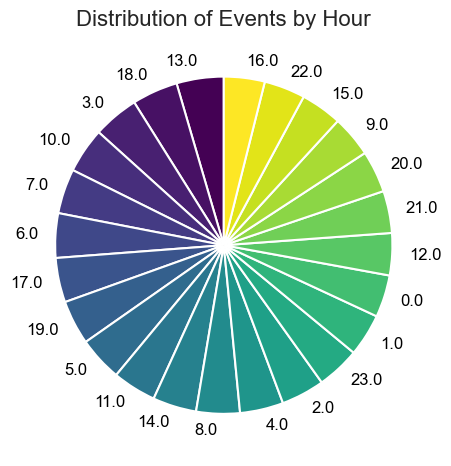

In [23]:
hour_counts = df['Hour'].value_counts()
create_pie_chart(hour_counts, 'Distribution of Events by Hour', cmap='viridis')

<B>Explanation:<br>

Shows the distribution of events across hours of the day based on the Hour column.
Each slice represents the number of events for an hour, as a percentage of the total.
What the Colors Represent:

The viridis colormap is used, ranging from yellow (fewer events) to purple (more events), with green/blue shades representing moderate values.
Insight from the Pie Chart:

Proportional Distribution: Larger slices indicate hours with more events.
Key Hour Segments: The chart visually highlights which hours are most or least active.
Visual Comparison: Percentages on slices help understand the relative contribution of each hour.
What the Legend Represents:

The legend links colors to specific hours, helping viewers identify time periods.

<B>Observation:<br>

The pie chart visualizes the frequency of events occurring during each hour of the day. Some hours may display significantly higher or lower proportions, highlighting patterns in event timing.

<b>Conclusion:<br>

The distribution of events by hour may reveal temporal trends, such as higher occurrences during specific periods (e.g., early morning or late evening). These trends could indicate natural cycles or operational influences on event reporting. Further analysis might be required to understand the causes of these patterns.


<br>

Event Distribution by Month

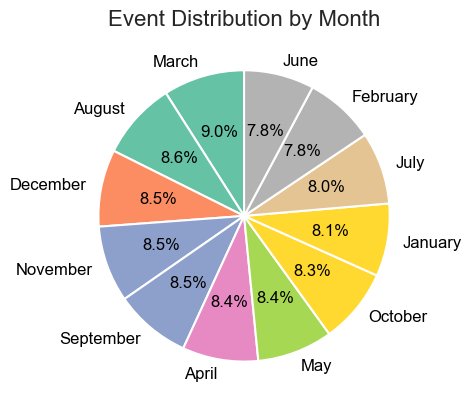

In [24]:
month_counts = df['Date'].dt.month_name().value_counts()
create_pie_chart(month_counts, 'Event Distribution by Month', cmap='Set2')

<B>Explanation:<br>

The pie chart for Event Distribution by Month visualizes the frequency of events (e.g., earthquakes) for each month of the year. Each slice represents one month, with the size of the slice proportional to the number of events that occurred in that month. The Set2 colormap is used to differentiate the months with distinct, aesthetically pleasing colors. This chart helps identify which months have the highest and lowest event occurrences, making it easier for customers to spot seasonal trends or patterns in the data. By looking at the size of each slice, viewers can immediately understand the monthly distribution of events.

<B>Observation:<br>

The pie chart shows the distribution of events across the months of the year. Certain months may have significantly higher or lower frequencies compared to others, indicating potential seasonal or temporal variations.

<b>Conclusion:<br>

The variation in event distribution by month could reflect underlying seasonal patterns, environmental factors, or operational reporting differences. For instance, higher counts in specific months might correspond to known seasonal phenomena, whereas uniform distributions may indicate consistent event occurrences throughout the year.


<br>


Event Distribution by Day of the Week


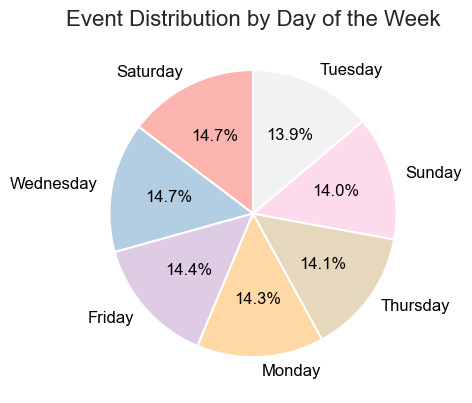

In [25]:
day_of_week_counts = df['Date'].dt.day_name().value_counts()
create_pie_chart(day_of_week_counts, 'Event Distribution by Day of the Week', cmap='Pastel1')

<B>Explanation:<br>

The pie chart displays the distribution of events across the days of the week, with each slice representing a day and its size proportional to the number of events. The Pastel1 colormap is used for distinct, soft colors, helping to quickly identify which days have higher or lower event occurrences.

<B>Observation:<br>

The pie chart represents the frequency of events occurring on each day of the week. Some days may show a higher proportion of events, while others are less represented.

<b>Conclusion:<br>

The distribution of events across the week might highlight specific patterns, such as operational scheduling, natural cycles, or reporting tendencies. Peaks on certain days could point to human activity or natural phenomena tied to weekly rhythms, while uniform distributions suggest no significant weekday influence.


<br>

Event Distribution by Quarter

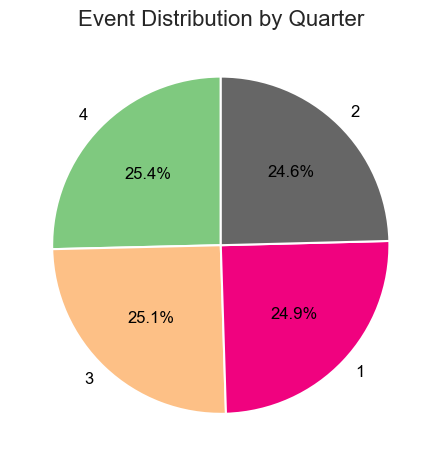

In [26]:
quarter_counts = df['Date'].dt.quarter.value_counts()
create_pie_chart(quarter_counts, 'Event Distribution by Quarter', cmap='Accent')

<B>Explanation:<br>

The pie chart shows the distribution of events across the four quarters (Q1–Q4), with each sector sized by the number of events and labeled with its percentage. Distinct colors from the Accent colormap represent each quarter, making it easy to differentiate. The title, "Event Distribution by Quarter," highlights its purpose, helping customers identify the quarter with the highest or lowest events and understand seasonal trends.
<br>

<B>Observation:<br>

The pie chart illustrates how events are distributed across the four quarters of the year (Q1, Q2, Q3, Q4). Each segment represents the proportion of events that occurred in the respective quarters.

<b>Conclusion:<br>

The distribution across quarters may reveal temporal trends or seasonality in event occurrences. For instance, one quarter showing higher activity could suggest seasonal environmental influences, reporting patterns, or other cyclical factors impacting the number of recorded events during that period.

<br>

 Event Occurrences Over Time

In [27]:
df['Date'] = pd.to_datetime(df['Date'])
event_by_date = df.groupby('Date').size().reset_index(name='Event Count')
fig1 = px.line(event_by_date, x='Date', y='Event Count', title='Event Occurrences Over Time')
fig1.show()


<B>Explanation:<br>

This plot shows the number of events over time.
X-Axis: Dates of the events.
Y-Axis: Number of events on each date.
Line: The line connects data points to show how event counts change day by day.
It helps identify trends, like busy or quiet periods, making it easy to see when events peaked or dropped.

<B>Observation:<br>

The line chart shows the number of events recorded over time, highlighting fluctuations in event frequency across the observed time range. There may be identifiable trends, such as periods with increased or decreased activity.

<b>Conclusion:<br>

The observed trends in event occurrences suggest patterns or shifts in event frequency over time. These patterns could indicate natural cycles, environmental changes, or variations in reporting practices. Further analysis could help determine the underlying causes of these trends.


<br>

Custom Pie Chart Plotting Function

In [28]:
def plot_pie(data, labels, title):
    plt.figure(figsize=(6, 6))
    plt.pie(data, labels=labels, autopct='%1.1f%%', startangle=140)
    plt.title(title)
    plt.show()

<br>

Event Frequency by Weekday

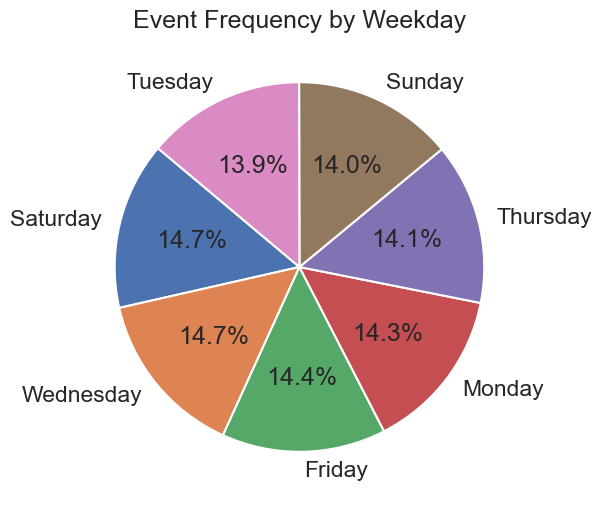

In [29]:
df['Weekday'] = df['Date'].dt.day_name()
weekday_counts = df['Weekday'].value_counts()
plot_pie(weekday_counts, weekday_counts.index, 'Event Frequency by Weekday')

<B> Explanation:<br>

The pie chart displays how events are distributed across the days of the week, with each slice representing the number of events for a specific weekday. The size of each slice is proportional to the number of events, where larger slices indicate more events. It allows for easy identification of weekdays with the most and least events, helping to spot trends, such as higher activity on Mondays and lower on Sundays. Overall, the plot provides a clear view of event frequency by weekday, aiding in recognizing patterns in event distribution.

<B>Observation:<br>

The pie chart represents the distribution of events across the days of the week. It shows how events are spread across weekdays and weekends, highlighting any dominant days.

<b>Conclusion:<br>

The analysis reveals patterns in event occurrences by day of the week. Certain days may show higher activity, possibly reflecting operational schedules, natural cycles, or reporting behaviors. Further investigation could help identify the factors contributing to these trends.


<br>

Distribution of Earthquake Magnitudes

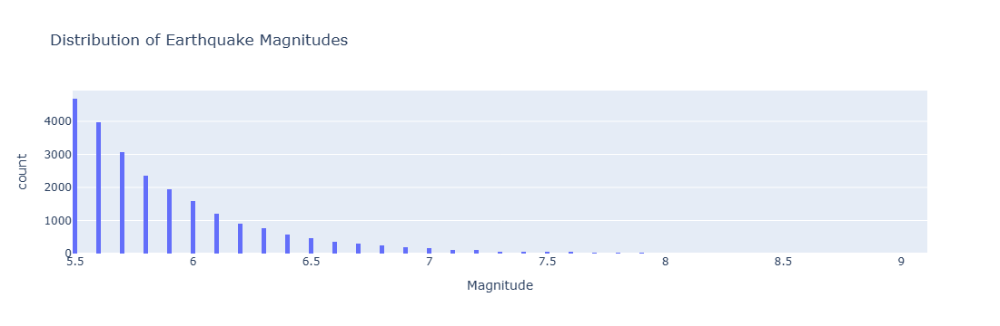

In [30]:
fig = px.histogram(df, x='Magnitude', title='Distribution of Earthquake Magnitudes')
fig.show()

<B>Explanation:<br>

The histogram shows the distribution of earthquake magnitudes in the dataset, with the x-axis representing the magnitude values and the y-axis representing the frequency of each magnitude range. The plot provides a visual representation of how earthquake magnitudes are spread, allowing customers to easily see which magnitude ranges are most common and how frequent lower or higher magnitudes are. It helps identify patterns, such as whether most earthquakes in the dataset have smaller or larger magnitudes, providing insights into the overall distribution of earthquake severity.
<br>

<B>Observation:<br>

The histogram shows that most earthquakes have smaller magnitudes, with frequency decreasing as magnitude increases.

<b>Conclusion:<br>

Smaller magnitude earthquakes are more common, which is typical in seismic activity globally.


<br>

Earthquake Locations by Magnitude

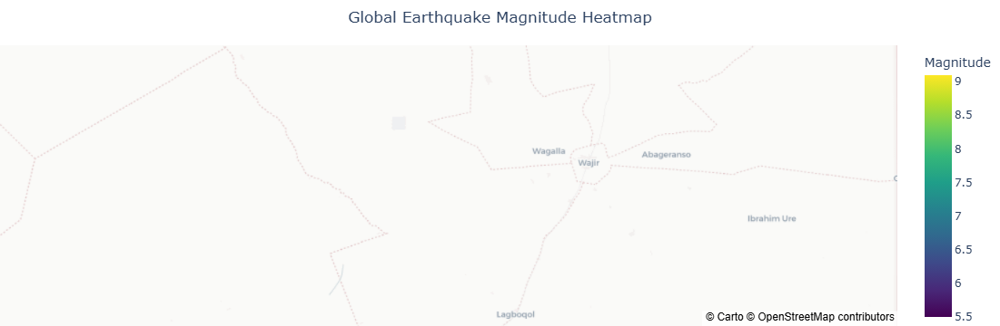

In [31]:
# Create a geographic heatmap visualization
fig = px.density_mapbox(
    df,
    lat='Latitude',
    lon='Longitude',
    z='Magnitude',  # Weight earthquake magnitudes for heat intensity
    hover_data=['Date', 'Depth', 'Type'],
    title='Global Earthquake Magnitude Heatmap',
    color_continuous_scale='Viridis',  # Intuitive color scale
    radius=20  # Adjust radius to control heatmap smoothness
)

# Customize layout for better visualization
fig.update_layout(
    mapbox_style="carto-positron",  # Use a clean map style for better visualization
    margin=dict(l=0, r=0, b=0, t=50),  # Remove margins for better fit
    title_x=0.5  # Center the title
)

# Show interactive heatmap
fig.show()


<B>Explanation:<br>

The geographic heatmap visualizes the global distribution of earthquake magnitudes, using the latitude and longitude coordinates from the dataset. The heat intensity is weighted by earthquake magnitudes, with higher magnitudes represented by more intense colors. The plot provides an interactive view of where the most significant earthquakes have occurred around the world, helping customers identify patterns in earthquake activity. The clean map style and intuitive color scale make it easy to spot areas with high earthquake intensity, offering valuable insights into global seismic activity.








<B>Observation:<br>

The scatter plot visualizes earthquake locations on a map, with the X-axis representing longitude and the Y-axis representing latitude. The color of the points corresponds to the magnitude, showing how larger magnitude earthquakes are distributed across different geographical regions.s.

<b>Conclusion:<br>

This plot provides a clear view of earthquake locations and their magnitudes, helping identify regions with more frequent or stronger seismic activity.


<br>

Root Mean Square (RMS) of Earthquakes Over Time

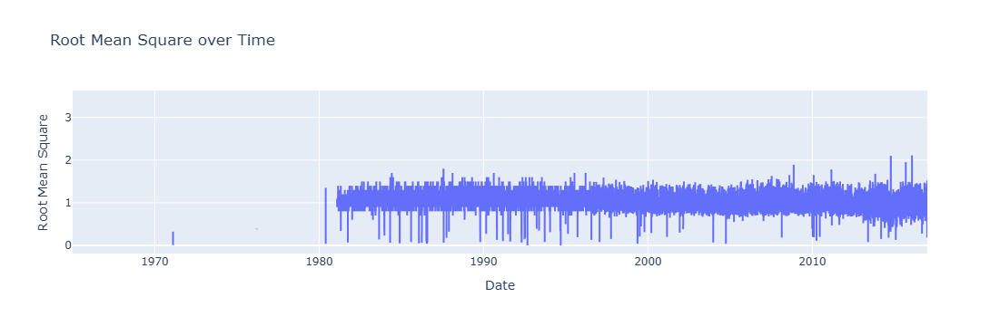

In [32]:
fig = px.line(df, x='Date', y='Root Mean Square', title='Root Mean Square over Time')
fig.show()


<B> Explanation:<br>

This line plot visualizes the Root Mean Square (RMS) values over time. The x-axis represents the dates, while the y-axis shows the RMS values. The plot displays how the RMS values change over time, helping customers observe trends or fluctuations in the data. By examining the line, one can quickly identify periods of higher or lower RMS, providing insights into patterns or anomalies that may occur over time. The interactive plot allows for zooming and hovering over points for more detailed information.

<B>Observation:<br>

The line plot illustrates the variation of the Root Mean Square (RMS) of earthquakes over time, with the X-axis representing dates and the Y-axis indicating the RMS values. The plot reveals fluctuations in the RMS, which can suggest changes in seismic energy over the observed period.


<b>Conclusion:<br>

This RMS plot provides insights into the intensity or energy variation of seismic events over time, highlighting periods with significant seismic activity or energy releases. Such information can be useful for analyzing the magnitude and frequency of strong seismic events.


<br>

Cumulative Earthquake Count Over Time

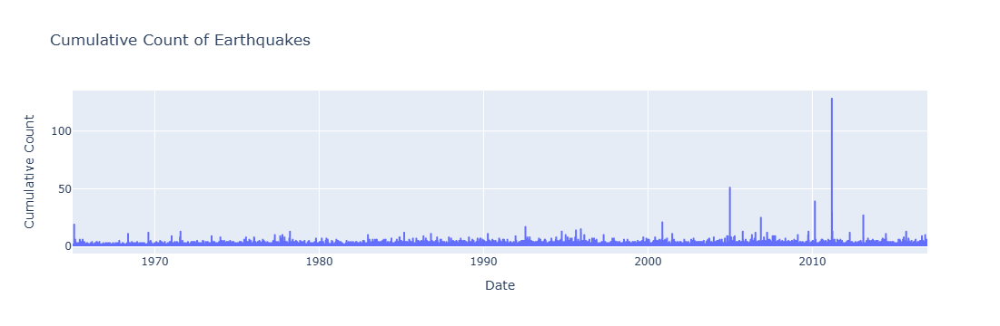

In [33]:
df['Cumulative Count'] = df.groupby('Date').cumcount() + 1
fig = px.line(df, x='Date', y='Cumulative Count', title='Cumulative Count of Earthquakes')
fig.show()

<B>Explantion:<br>

This line plot visualizes the cumulative count of earthquakes over time. The x-axis represents the dates, while the y-axis shows the cumulative count of earthquakes, meaning each point reflects the total number of earthquakes that have occurred up to that date. As the plot progresses, the line steadily increases, helping customers track how earthquake occurrences accumulate over time. This plot can highlight trends in earthquake frequency, allowing users to see periods of increased activity or relative calm. The interactive nature of the plot lets users explore specific dates and counts.

<B>Observation:<br>

The line plot shows the cumulative count of earthquakes over time, with the X-axis representing dates and the Y-axis indicating the running total of earthquakes. The plot illustrates how earthquake activity increases over the given time period, showing clear trends or patterns in seismic occurrences.

<b>Conclusion:<br>

The cumulative count plot provides a clear overview of earthquake frequency over time, helping to visualize trends in seismic activity and identify periods of increased seismic events. This can assist in recognizing potential clusters or significant seismic periods.

<br>

3D Visualization of Earthquake Locations with Magnitude

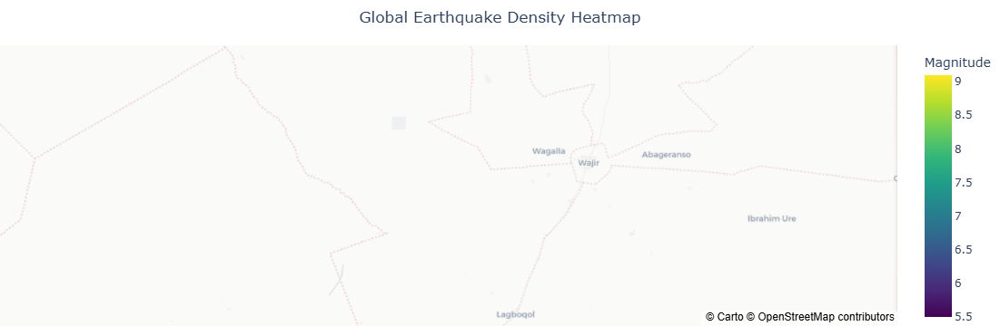

In [34]:
# Create a geographic heatmap visualization
fig = px.density_mapbox(
    df,
    lat='Latitude',
    lon='Longitude',
    z='Magnitude',  # Weight earthquake magnitudes for heat intensity
    hover_data=['Date', 'Depth', 'Type'],
    title='Global Earthquake Density Heatmap',
    color_continuous_scale='Viridis',  # Intuitive color scale
    radius=20  # Adjust radius to control heatmap smoothness
)

# Customize layout for better visualization
fig.update_layout(
    mapbox_style="carto-positron",  # Use a clean map style for better visualization
    margin=dict(l=0, r=0, b=0, t=50),  # Remove margins for better fit
    title_x=0.5  # Center the title
)

# Show interactive heatmap
fig.show()


<B>Explanation:<br>

This geographic heatmap visualizes the global distribution of earthquake magnitudes, using latitude and longitude to pinpoint their locations on the map. The heat intensity is based on the earthquake magnitude, with brighter colors indicating stronger events. Hovering over the map reveals additional information like the earthquake's date, depth, and type. The use of the Viridis color scale makes the map colorblind-friendly, while the clean carto-positron map style ensures clear visualization. This interactive plot allows customers to easily identify high-magnitude earthquake zones and explore patterns in seismic activity worldwide.

<B>Observation:<br>

The plot shows earthquake locations with varying magnitudes, where color indicates magnitude intensity, and points are distributed across different latitudes and longitudes.

<b>Conclusion:<br>

This 3D visualization helps identify patterns in earthquake magnitudes and locations, aiding in the analysis of seismic activity and preparedness efforts.
